<a href="https://colab.research.google.com/github/wenyanyin/CP_violation_simulation/blob/master/DAIP5_group6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Bitcoin Forecasting by Machine Learning 

#### Google Drive loading 

If you use Jupyter notebook you may skip this section

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!cd '/content/drive/MyDrive/Colab Notebooks/'
!pwd

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content


#### Import/Install required Libraries

In [ ]:
import pandas as pd
import numpy as np
import sklearn
from sklearn import datasets
from sklearn import metrics
import random as rd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.metrics import mean_squared_error

system information

In [ ]:
import sys
print(sys.version)
print(sys.executable)

3.7.12 (default, Jan 15 2022, 18:48:18) 
[GCC 7.5.0]
/usr/bin/python3


In [ ]:
!pip install yfinance

     |████████████████████████████████| 63 kB 1.4 MB/s 
     |████████████████████████████████| 6.4 MB 10.9 MB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: lxml
    Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
!pip install coinmetrics-api-client

     |████████████████████████████████| 54 kB 1.8 MB/s 
     |████████████████████████████████| 255 kB 9.9 MB/s 


In [ ]:
!pip install quandl

In [ ]:
!pip install pytrends

  Created wheel for pytrends: filename=pytrends-4.8.0-py3-none-any.whl size=16126 sha256=4d2de5d63e3121674b66a0a4611094902bb0acdca4dc285334df9d7942b5098b
  Stored in directory: /root/.cache/pip/wheels/07/6f/5c/8174f98dec1bfbc7d5da4092854afcbcff4b26c3d9b66b5183
Successfully built pytrends


In [ ]:
!pip install -U pandas-profiling

     |████████████████████████████████| 261 kB 3.6 MB/s 
     |████████████████████████████████| 10.9 MB 52.9 MB/s 
     |████████████████████████████████| 63 kB 797 kB/s 
     |████████████████████████████████| 102 kB 11.5 MB/s 
     |████████████████████████████████| 3.1 MB 42.8 MB/s 
     |████████████████████████████████| 596 kB 42.0 MB/s 
     |████████████████████████████████| 687 kB 46.4 MB/s 
     |████████████████████████████████| 303 kB 43.8 MB/s 
     |████████████████████████████████| 812 kB 56.1 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=793a86fffd2a29b19dc1f255d972ae73af3f4e4808b0c5a661aa222c4b501a57
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295206 sha256=b33310c935ae7470b89fa70cb07d9dad32622435b1cf002b417eefe2e5a4470b
 

## Retrieving data from varies sources

Resources list: 
1. Yahoo Finance ("BTC price",	"DJI",	"Nasdaq composite index",	"Gold in USD")
2. Coin matrix ("Ethereum Price",	"Litecoin Price",	"Bitcoin Cash Price",	"Cardano Price")
3. Quandl ("BTC network hashrate",	"Average BTC block size",	"NUAU-BTC", "Number TX-BTC",	"Difficulty-BTC",	"TX fees-BTC",	"Estimated TX Volume USD-BTC")
4. Google trends 

In [ ]:
#Define Start date of data
start_date='2017-12-01'

#Define end date of data
end_date='2022-03-10'

In [ ]:
import yfinance as yf
BTC=yf.download('BTC-USD',start=start_date,end=end_date)
BTC=BTC['Close']
DJI=yf.download('^DJI',start=start_date,end=end_date)
DJI=DJI['Close']
Nasdaq=yf.download('^IXIC',start=start_date,end=end_date)
Nasdaq=Nasdaq['Close']
gold=yf.download('GLD',start=start_date,end=end_date)
gold=gold['Close']

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


In [ ]:
from coinmetrics.api_client import CoinMetricsClient

# use community API:
client = CoinMetricsClient()

eth=client.get_asset_metrics(assets='eth', 
                                            start_time=start_date,
                                            end_time=end_date,
                                            metrics=['PriceUSD']).to_dataframe()
eth=eth.PriceUSD

ltc=client.get_asset_metrics(assets='ltc', 
                                            start_time=start_date,
                                            end_time=end_date,
                                            metrics=['PriceUSD']).to_dataframe()
ltc=ltc.PriceUSD

bch=client.get_asset_metrics(assets='bch', 
                                            start_time=start_date,
                                            end_time=end_date,
                                            metrics=['PriceUSD']).to_dataframe()
bch=bch.PriceUSD

ada=client.get_asset_metrics(assets='ada', 
                                            start_time=start_date,
                                            end_time=end_date,
                                            metrics=['PriceUSD']).to_dataframe()
ada=ada.PriceUSD

In [ ]:
import quandl
quandl.ApiConfig.api_key = 'sH4aW2PxW28XqTxxiots'
hash_rate=quandl.get('BCHAIN/HRATE', start_date=start_date, end_date=end_date)
avg_block=quandl.get('BCHAIN/AVBLS', start_date=start_date, end_date=end_date)
nuau=quandl.get('BCHAIN/NADDU', start_date=start_date, end_date=end_date)
number_tx=quandl.get('BCHAIN/NTRAT', start_date=start_date, end_date=end_date)
difficulty=quandl.get('BCHAIN/DIFF', start_date=start_date, end_date=end_date)
tx_fee=quandl.get('BCHAIN/TRFEE', start_date=start_date, end_date=end_date)
tx_volumn=quandl.get('BCHAIN/ETRVU', start_date=start_date, end_date=end_date)

In [ ]:
from pytrends.request import TrendReq
pytrend = TrendReq()
pytrend.build_payload(kw_list=['Bitcoin'],cat=0, timeframe='2017-12-1 2022-3-10')
google= pytrend.interest_over_time()
google.columns=["Google trends",""]
google=google["Google trends"]

Connecting all the feature columns into one Data Frame 

In [ ]:
df=pd.concat([BTC,DJI,Nasdaq,gold], axis=1)
df.columns=["BTC price","DJI","Nasdaq composite index","Gold in USD"]

df2=pd.concat([eth,ltc,bch,ada], axis=1)
df2.columns=["Ethereum Price","Litecoin Price","Bitcoin Cash Price","Cardano Price"]
df2=df2.set_index(df.index.values)

df3=pd.concat([hash_rate,avg_block,nuau,number_tx,difficulty,tx_fee,tx_volumn], axis=1)
df3.columns=["BTC network hashrate","Average BTC block size","NUAU - BTC","Number TX - BTC","Difficulty - BTC","TX fees - BTC","Estimated TX Volume USD - BTC"]

In [ ]:
df=pd.concat([df,df2,df3,google], axis=1)
df.reset_index(inplace=True)
df.rename(columns={"index":"Date"},inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1561 entries, 0 to 1560
Data columns (total 17 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   Date                           1561 non-null   datetime64[ns]
 1   BTC price                      1561 non-null   float64       
 2   DJI                            1074 non-null   float64       
 3   Nasdaq composite index         1074 non-null   float64       
 4   Gold in USD                    1074 non-null   float64       
 5   Ethereum Price                 1561 non-null   Float64       
 6   Litecoin Price                 1561 non-null   Float64       
 7   Bitcoin Cash Price             1561 non-null   Float64       
 8   Cardano Price                  1561 non-null   Float64       
 9   BTC network hashrate           1561 non-null   float64       
 10  Average BTC block size         1561 non-null   float64       
 11  NUAU - BTC       

Dividing data into testing and training and storing them in a separate file

_Notice !_: If you are using Jupyter Notebook, please save the files in your own directory

In [ ]:
test=df.iloc[-90:,:]
data=df.iloc[:-90,:]

df.to_csv('/content/drive/MyDrive/Colab Notebooks/Bitcoin_update.csv',index=False)
data.to_csv('/content/drive/MyDrive/Colab Notebooks/Bitcoin_train.csv',index=False)
test.to_csv('/content/drive/MyDrive/Colab Notebooks/Bitcoin_test.csv',index=False)

# Training

Read train data file retrieving before

_Notice !_: If you are using Jupyter Notebook, please read the files from your own directory

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bitcoin_train.csv')
data.set_index('Date',inplace=True)
data

,BTC price,DJI,Nasdaq composite index,Gold in USD,Ethereum Price,Litecoin Price,Bitcoin Cash Price,Cardano Price,BTC network hashrate,Average BTC block size,NUAU - BTC,Number TX - BTC,Difficulty - BTC,TX fees - BTC,Estimated TX Volume USD - BTC,Google trends
Date,,,,,,,,,,,,,,,,
2017-12-01,10975.599609,24231.589844,6847.589844,121.589996,269.057187,138.159956,422.851638,0.091729,1.225364e+07,1.068085,869274.0,276655859.0,1.347001e+12,247.051906,2.679696e+09,NaN
2017-12-02,11074.599609,NaN,NaN,NaN,269.848519,136.867408,428.842621,0.092413,1.078053e+07,1.036298,683882.0,277367060.0,1.347001e+12,190.295853,1.985358e+09,NaN
2017-12-03,11323.200195,NaN,NaN,NaN,273.714095,134.235130,432.093197,0.093340,1.178493e+07,1.047375,762993.0,277720104.0,1.347001e+12,187.451143,2.065024e+09,86.0
2017-12-04,11657.200195,24290.050781,6775.370117,121.180000,263.702252,135.351429,412.083748,0.088730,1.211972e+07,1.068300,885109.0,277747090.0,1.347001e+12,226.119910,2.601197e+09,NaN
2017-12-05,11916.700195,24180.640625,6762.209961,120.320000,268.936838,136.539092,415.848373,0.089784,1.191885e+07,1.058659,891235.0,278526499.0,1.347001e+12,219.679754,2.667850e+09,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-06,50582.625000,35227.031250,15225.150391,166.220001,132.696165,56.249269,127.592278,0.047035,1.909736e+08,1.096123,701524.0,692614251.0,2.233566e+13,12.987698,7.568392e+09,NaN
2021-12-07,50700.085938,35719.429688,15686.919922,166.809998,131.133712,55.135993,127.348081,0.046138,1.709880e+08,1.207006,725368.0,692898231.0,2.233566e+13,11.386833,6.656839e+09,NaN
2021-12-08,50504.796875,35754.750000,15786.990234,166.899994,131.309283,55.532214,131.210202,0.047366,1.865324e+08,0.951603,660440.0,693186796.0,2.233566e+13,10.347112,6.017763e+09,NaN


### Data exploring

In [ ]:
import pandas_profiling
data.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Columns with Null values need to address: Google trends, DJI, Nasdaq composite index, Gold in USD, NUAU - BTC, Estimated TX Volume USD - BTC (for `test` set). 

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1471 entries, 2017-12-01 to 2021-12-10
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   BTC price                      1471 non-null   float64
 1   DJI                            1014 non-null   float64
 2   Nasdaq composite index         1014 non-null   float64
 3   Gold in USD                    1014 non-null   float64
 4   Ethereum Price                 1471 non-null   float64
 5   Litecoin Price                 1471 non-null   float64
 6   Bitcoin Cash Price             1471 non-null   float64
 7   Cardano Price                  1471 non-null   float64
 8   BTC network hashrate           1471 non-null   float64
 9   Average BTC block size         1471 non-null   float64
 10  NUAU - BTC                     1471 non-null   float64
 11  Number TX - BTC                1471 non-null   float64
 12  Difficulty - BTC               1471 no

In [ ]:
#Fill missing values for Google trends
data['Google trends']=data['Google trends'].fillna(method='ffill').fillna(method='bfill')

#fill missing value for rest columns
data[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC']]=\
data[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC']].\
interpolate(method='linear', axis=0,limit_direction='both')

Exploring data again after cleaning 

In [ ]:
data.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Data preprocessing

Divide data into target and features

In [ ]:
y = data["BTC price"]
x = data.iloc[:,1:]
x.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1471 entries, 2017-12-01 to 2021-12-10
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   DJI                            1471 non-null   float64
 1   Nasdaq composite index         1471 non-null   float64
 2   Gold in USD                    1471 non-null   float64
 3   Ethereum Price                 1471 non-null   float64
 4   Litecoin Price                 1471 non-null   float64
 5   Bitcoin Cash Price             1471 non-null   float64
 6   Cardano Price                  1471 non-null   float64
 7   BTC network hashrate           1471 non-null   float64
 8   Average BTC block size         1471 non-null   float64
 9   NUAU - BTC                     1471 non-null   float64
 10  Number TX - BTC                1471 non-null   float64
 11  Difficulty - BTC               1471 non-null   float64
 12  TX fees - BTC                  1471 no

#### Split data into train and test

In [ ]:
from sklearn.model_selection import cross_val_score,KFold
kf =KFold(random_state=42, shuffle=True)

for train_index, test_index in kf.split(x, y):
  xtrain, xtest = x.iloc[train_index], x.iloc[test_index]
  ytrain, ytest = y.iloc[train_index], y.iloc[test_index]

xtrain.describe()

,DJI,Nasdaq composite index,Gold in USD,Ethereum Price,Litecoin Price,Bitcoin Cash Price,Cardano Price,BTC network hashrate,Average BTC block size,NUAU - BTC,Number TX - BTC,Difficulty - BTC,TX fees - BTC,Estimated TX Volume USD - BTC,Google trends
count,1177.000000,1177.000000,1177.000000,1177.000000,1177.000000,1177.000000,1177.000000,1.177000e+03,1177.000000,1177.000000,1.177000e+03,1.177000e+03,1177.000000,1.177000e+03,1177.000000
mean,27817.428192,9764.230093,145.279651,1081.134329,108.193027,527.327649,0.511636,8.809161e+07,1.093613,578236.024639,4.781075e+08,1.216835e+13,75.783776,2.227546e+09,19.574342
std,3712.546390,2797.709901,22.918684,1261.621597,67.826395,433.241001,0.685947,4.715222e+07,0.201818,128229.178144,1.255197e+08,6.501701e+12,115.657103,2.215987e+09,15.695924
min,18591.929688,6192.919922,111.099998,83.086535,22.856117,78.967964,0.024106,1.178493e+07,0.431452,310119.000000,2.766559e+08,1.347001e+12,8.247936,2.235127e+08,7.000000
25%,25191.429688,7554.459961,123.370003,200.986968,52.203729,253.488145,0.051990,4.407899e+07,0.967547,477898.000000,3.590034e+08,6.353031e+12,21.336906,7.937114e+08,10.000000
50%,26522.610677,8253.506836,141.759995,423.346332,83.551116,411.722623,0.130808,9.204596e+07,1.108507,561108.000000,4.768951e+08,1.295595e+13,36.043150,1.318870e+09,12.000000
75%,29793.563151,12036.790039,166.979996,1811.143223,153.946309,624.017332,0.993747,1.262882e+08,1.265250,670883.000000,5.893926e+08,1.755799e+13,88.318231,2.728063e+09,25.000000
max,36432.218750,16057.440430,193.889999,4662.761200,385.473618,3094.012818,2.965479,1.985140e+08,1.512784,978252.000000,6.937364e+08,2.504649e+13,1065.615595,1.464262e+10,100.000000


In [ ]:
#store date 
date=xtest.index.values

#store features' name
features=xtrain.columns.tolist()

#### Scaling data 

In [ ]:
ytrain=ytrain.values.reshape(-1,1)
ytest=ytest.values.reshape(-1,1)

from sklearn.preprocessing import StandardScaler
std_scale = StandardScaler()

xtrain= std_scale.fit_transform(xtrain)
xtest=std_scale.fit_transform(xtest)

ytrain= std_scale.fit_transform(ytrain)
ytest=std_scale.fit_transform(ytest)

#transforming array to data frame
xtrain=pd.DataFrame(xtrain,columns=features)
xtest=pd.DataFrame(xtest,columns=features)

xtrain.describe()

,DJI,Nasdaq composite index,Gold in USD,Ethereum Price,Litecoin Price,Bitcoin Cash Price,Cardano Price,BTC network hashrate,Average BTC block size,NUAU - BTC,Number TX - BTC,Difficulty - BTC,TX fees - BTC,Estimated TX Volume USD - BTC,Google trends
count,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03,1.177000e+03
mean,5.844471e-16,-2.116687e-16,1.783714e-16,2.669440e-16,6.744345e-17,-1.603551e-17,-6.088776e-16,2.935441e-16,-4.248938e-16,1.218699e-16,1.445082e-16,-1.120976e-15,2.211013e-16,-3.510833e-16,-2.929781e-16
std,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00,1.000425e+00
min,-2.486008e+00,-1.277055e+00,-1.491978e+00,-7.914196e-01,-1.258701e+00,-1.035337e+00,-7.110425e-01,-1.618993e+00,-3.282387e+00,-2.091809e+00,-1.605623e+00,-1.665095e+00,-5.841798e-01,-9.047372e-01,-8.014620e-01
25%,-7.076315e-01,-7.901854e-01,-9.563796e-01,-6.979284e-01,-8.258304e-01,-6.323407e-01,-6.703749e-01,-9.338126e-01,-6.249198e-01,-7.828224e-01,-9.492908e-01,-8.948111e-01,-4.709613e-01,-6.473164e-01,-6.102483e-01
50%,-3.489163e-01,-5.402152e-01,-1.536368e-01,-5.216046e-01,-3.634630e-01,-2.669511e-01,-5.554218e-01,8.389921e-02,7.383105e-02,-1.336303e-01,-9.663160e-03,1.211889e-01,-3.437534e-01,-4.102293e-01,-4.827726e-01
75%,5.325119e-01,8.126382e-01,9.472433e-01,5.788734e-01,6.748513e-01,2.232725e-01,7.031396e-01,8.104142e-01,8.508157e-01,7.228180e-01,8.869724e-01,8.293110e-01,1.084221e-01,2.259624e-01,3.458200e-01
max,2.321440e+00,2.250371e+00,2.121894e+00,2.840114e+00,4.089830e+00,5.926900e+00,3.578831e+00,2.342824e+00,2.077859e+00,3.120865e+00,1.718620e+00,1.981575e+00,8.561969e+00,5.604883e+00,5.126162e+00


## Multiple Linear regression

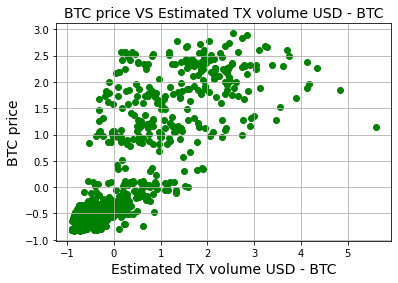

In [ ]:
bitcoin_train=xtrain
bitcoin_test=xtest

import pandas as pd
import matplotlib.pyplot as plt
plt.scatter(bitcoin_train['Estimated TX Volume USD - BTC'],ytrain, color='green')
plt.title('BTC price VS Estimated TX volume USD - BTC', fontsize=14)
plt.xlabel('Estimated TX volume USD - BTC', fontsize=14)
plt.ylabel('BTC price', fontsize=14)
plt.grid(True)
plt.show()

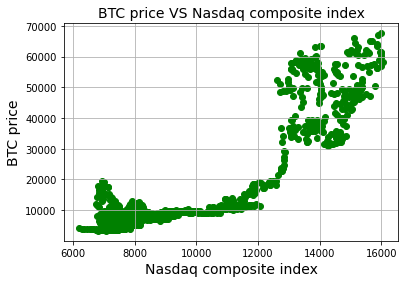

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
plt.scatter(bitcoin_train['Nasdaq composite index'],ytrain, color='green')
plt.title('BTC price VS Nasdaq composite index', fontsize=14)
plt.xlabel('Nasdaq composite index', fontsize=14)
plt.ylabel('BTC price', fontsize=14)
plt.grid(True)
plt.show()

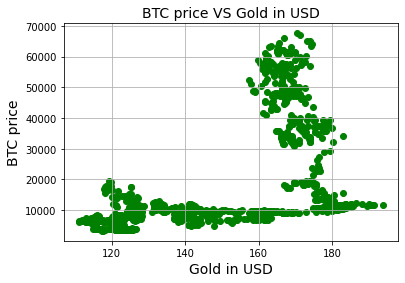

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
plt.scatter(bitcoin_train['Gold in USD'],ytrain, color='green')
plt.title('BTC price VS Gold in USD', fontsize=14)
plt.xlabel('Gold in USD', fontsize=14)
plt.ylabel('BTC price', fontsize=14)
plt.grid(True)
plt.show()

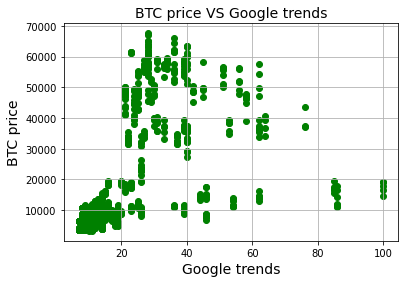

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
plt.scatter(bitcoin_train['Google trends'],ytrain, color='green')
plt.title('BTC price VS Google trends', fontsize=14)
plt.xlabel('Google trends', fontsize=14)
plt.ylabel('BTC price', fontsize=14)
plt.grid(True)
plt.show()

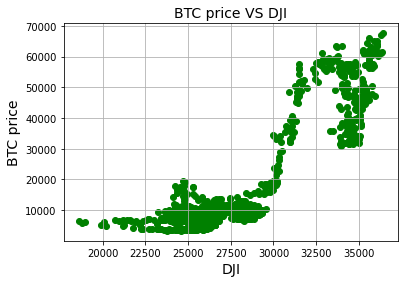

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
plt.scatter(bitcoin_train['DJI'],ytrain, color='green')
plt.title('BTC price VS DJI', fontsize=14)
plt.xlabel('DJI', fontsize=14)
plt.ylabel('BTC price', fontsize=14)
plt.grid(True)
plt.show()

In [ ]:
from sklearn import linear_model
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
names = pd.DataFrame(xtrain.columns) 

#use linear regression as the model
lin_reg = linear_model.LinearRegression()

#This is to select 5 variables: can be changed and checked in model for accuracy
rfe_mod = RFE(lin_reg,n_features_to_select=5, step=1)
myvalues=rfe_mod.fit(xtrain,ytrain) #to fit
ypred = myvalues.predict(xtest)# to predict 

myvalues.support_#The mask of selected features.
myvalues.ranking_ #The feature ranking, such that ranking_[i] corresponds to the ranking position of the i-th feature. Selected (i.e., estimated best) features are assigned rank 1.

rankings=pd.DataFrame(myvalues.ranking_) #Make it into data frame
ranked=pd.concat([names,rankings], axis=1) 
ranked.columns = ["Feature", "Rank"] 
ranked #Select most important (Only 1's) 
most_important = ranked.loc[ranked['Rank'] ==1] 
print(most_important) 
most_important['Rank'].count() 


                          Feature  Rank
1          Nasdaq composite index     1
2                     Gold in USD     1
7            BTC network hashrate     1
13  Estimated TX Volume USD - BTC     1
14                  Google trends     1


5

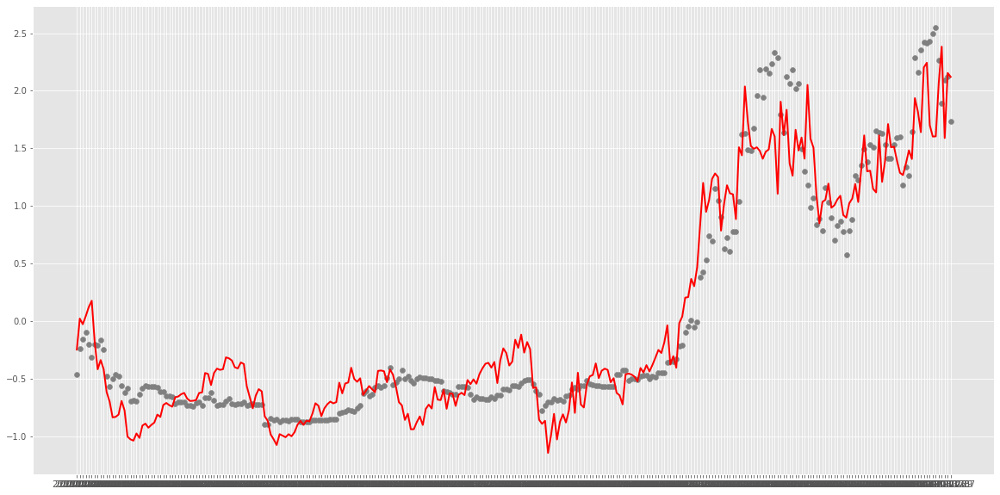

In [ ]:
#Scatter plot with a line for prediction vs test data. ( The line can show if it is a good prediction)
plt.figure(figsize=(20,10))
plt.scatter(date,ytest,  color='gray')
plt.plot(date,ypred, color='red', linewidth=2)
plt.show()

In [ ]:
#Important metrics for linear regression
print('Mean Absolute Error:', metrics.mean_absolute_error(ytest, ypred))  
print('Mean Squared Error:', metrics.mean_squared_error(ytest, ypred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(ytest, ypred)))

Mean Absolute Error: 0.22720451786377852
Mean Squared Error: 0.0860899670520386
Root Mean Squared Error: 0.2934109184267665


## Machine leanrning Models

### KNN

Grid Search to find best hyperparameters of model

In [ ]:
from pandas.core.common import random_state
# Grid Search for Parameter Tuning 
from sklearn.neighbors import KNeighborsRegressor 
from sklearn.model_selection import GridSearchCV

# prepare a range of alpha values to test
k_range = np.array([1,2,3,4,5,6,7,8,9,10])

knn = KNeighborsRegressor(n_neighbors=k_range)
grid = GridSearchCV(knn, param_grid=dict(n_neighbors=k_range), cv= kf,scoring='neg_mean_squared_error')
grid.fit(xtrain, ytrain)
print("grid:",grid)

# summarize the results of the grid search
print("grid.best_score_:",grid.best_score_)
print("grid.best_estimator_ (Best number of neighbors):",grid.best_estimator_.n_neighbors)

grid: GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             estimator=KNeighborsRegressor(n_neighbors=array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])},
             scoring='neg_mean_squared_error')
grid.best_score_: -0.019011102087901514
grid.best_estimator_ (Best number of neighbors): 4


Fit model and print the performance

In [ ]:
# Model for best neighbour
from sklearn.metrics import mean_squared_error

model = KNeighborsRegressor(n_neighbors=grid.best_estimator_.n_neighbors)
knn = model.fit(xtrain, ytrain)
knn_pred = knn.predict(xtest)

# train score
scores =  cross_val_score(model, xtrain, ytrain,cv=kf,scoring='neg_mean_squared_error')
print("Mean R-squared score for training (KNN):",scores)

#MSE for test set
print ("Mean Square error (KNN):", mean_squared_error(ytest, knn_pred))

Mean R-squared score for training (KNN): [-0.01781934 -0.01771873 -0.01893737 -0.01972034 -0.02085973]
Mean Square error (KNN): 0.03225263732516956


### Random forest

Grid Search to find best hyperparameters of Random Forest

In [ ]:
ytrain=ytrain.ravel()
ytest=ytest.ravel()

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
param_grid = { 'bootstrap': [True,False], 'max_depth': [5, 10, 15, 20], 'max_features': ['auto', 'log2','sqrt'],'max_leaf_nodes':[40,50,60]}

rfr = RandomForestRegressor(n_estimators=1000,random_state =42,n_jobs=-1)
grid = GridSearchCV(estimator = rfr, param_grid = param_grid, 
                          cv = kf, n_jobs = 1, verbose = 0,scoring='neg_mean_squared_error')
print("grid:",grid)

grid: GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             estimator=RandomForestRegressor(n_estimators=1000, n_jobs=-1,
                                             random_state=42),
             n_jobs=1,
             param_grid={'bootstrap': [True, False],
                         'max_depth': [5, 10, 15, 20],
                         'max_features': ['auto', 'log2', 'sqrt'],
                         'max_leaf_nodes': [40, 50, 60]},
             scoring='neg_mean_squared_error')


#### ***Caution !***: 

This cell may take quite long time! (around 30 minutes depends on your computer resources)

You may skip this cell of grid.fit() Directly ***JUMP*** to Buiding model

In [ ]:
grid.fit(xtrain, ytrain)

# summarize the results of the grid search
print("grid.best_score_:",grid.best_score_)
print("grid.best_estimator_:",grid.best_estimator_)

grid.best_score_: -0.006552789469418997
grid.best_estimator_: RandomForestRegressor(bootstrap=False, max_depth=10, max_features='log2',
                      max_leaf_nodes=60, n_estimators=1000, n_jobs=-1,
                      random_state=42)


***Buiding model*** with best hyperparameters

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(bootstrap=False, max_depth=10, max_features='log2',
                      max_leaf_nodes=60, n_estimators=1000, n_jobs=-1,
                      random_state=42)
rfr.fit(xtrain,ytrain)
rfr_pred=rfr.predict(xtest)

In [ ]:
from sklearn.metrics import mean_squared_error
# train score
scores =  cross_val_score(rfr, xtrain, ytrain,cv=kf,scoring="neg_mean_squared_error")
print("Mean R-squared score for training (Random Forest):",scores)

#MSE for test set
print ("Mean Square error (Random Forest):", mean_squared_error(ytest, rfr_pred))

Mean R-squared score for training (Random Forest): [-0.00424479 -0.00678304 -0.00610787 -0.00958702 -0.00604123]
Mean Square error (Random Forest): 0.051510826257862685


#### ***Feature importance***

The random forest model will rank the importance of features automatically

In [ ]:
importances = rfr.feature_importances_
indices = np.argsort(importances)[::-1]
print("Feature importance ranked by random forest with weights: \n")
for i in range(xtrain.shape[1]):
    print("%2d) %-*s %f" % (i + 1, 30, features[indices[i]], importances[indices[i]]))

Feature importance ranked by random forest with weights: 

 1) Number TX - BTC                0.246152
 2) DJI                            0.188994
 3) Nasdaq composite index         0.162567
 4) Difficulty - BTC               0.095775
 5) Google trends                  0.093841
 6) Estimated TX Volume USD - BTC  0.058264
 7) Gold in USD                    0.043571
 8) BTC network hashrate           0.036621
 9) Bitcoin Cash Price             0.021662
10) Litecoin Price                 0.014541
11) Ethereum Price                 0.010774
12) NUAU - BTC                     0.010208
13) Cardano Price                  0.009218
14) Average BTC block size         0.004288
15) TX fees - BTC                  0.003525


### SVM

Support Vector Machine 

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import LinearSVR

svm= LinearSVR(tol=1e-5,max_iter=100000)

scores = cross_val_score(svm, xtrain, ytrain, scoring="neg_mean_squared_error", cv=kf)
svm_reg_rmse_scores = np.sqrt(-scores)
print(svm_reg_rmse_scores.mean())

svm.fit(xtrain,ytrain)
svm_pred=svm.predict(xtest)
print ("Mean Square error (SVM):", mean_squared_error(ytest, svm_pred))

0.29537405284143026
Mean Square error (SVM): 0.10369326130677729


### Voting 

Ensemble Machine Learning

In [ ]:
from sklearn.ensemble import VotingRegressor

voting_reg = VotingRegressor(
    estimators=[('knn', knn), ('rf', rfr),('svm', svm)])

#fit model
voting_reg.fit(xtrain, ytrain)

VotingRegressor(estimators=[('knn', KNeighborsRegressor(n_neighbors=4)),
                            ('rf',
                             RandomForestRegressor(bootstrap=False,
                                                   max_depth=10,
                                                   max_features='log2',
                                                   max_leaf_nodes=60,
                                                   n_estimators=1000, n_jobs=-1,
                                                   random_state=42)),
                            ('svm', LinearSVR(max_iter=100000, tol=1e-05))])

In [ ]:
for reg in (knn, rfr, svm, voting_reg):
    reg.fit(xtrain, ytrain)
    ypred = reg.predict(xtest)
    print(reg.__class__.__name__, mean_squared_error(ytest, ypred))

KNeighborsRegressor 0.03225263732516956
RandomForestRegressor 0.051510826257862685
LinearSVR 0.10373747800562529
VotingRegressor 0.03540476755963898


## Statistic Models/Analysis

### Vector Auto-Regressive models (VAR)


In [ ]:
from statsmodels.tsa.stattools import adfuller
from sklearn import metrics
from timeit import default_timer as timer
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import os

df=data

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


#### _Caution !_: This plot will run 17 minutes

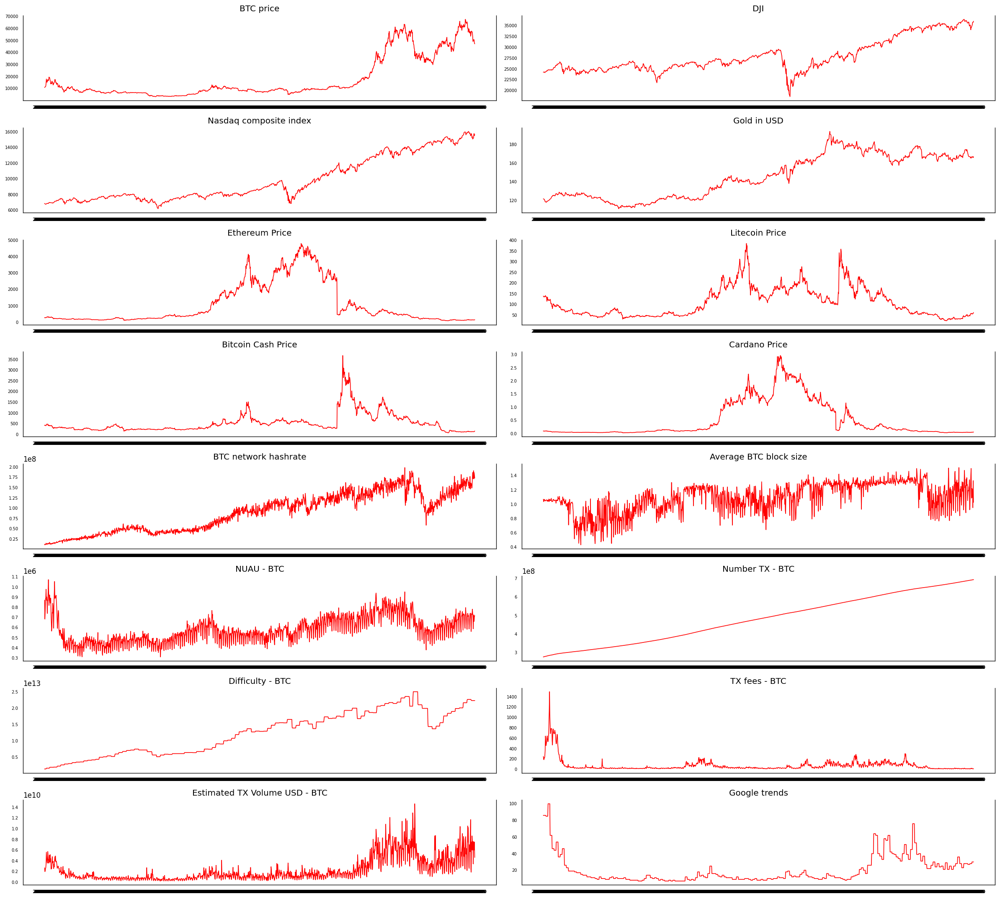

In [ ]:
# Plot
fig, axes = plt.subplots(nrows=8, ncols=2, dpi=120, figsize=(20,18))
for i, ax in enumerate(axes.flatten()):
    data = df[df.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

We can observe that the dataset is not stationary as trends, seasonability and cyclicality are present in many variables of the dataset.We need to remove the trend, variance, and seasonal components. Let's analyze the price of Bitcoin and plot it to see if it's stationary.

### BTC 50 and 200 days moving averages 
A typical example in trading is using the 50-day and 200-day moving averages to enter and exit an asset.
if the price is above a moving average, the trend is up. If the price is below a moving average, the trend is down

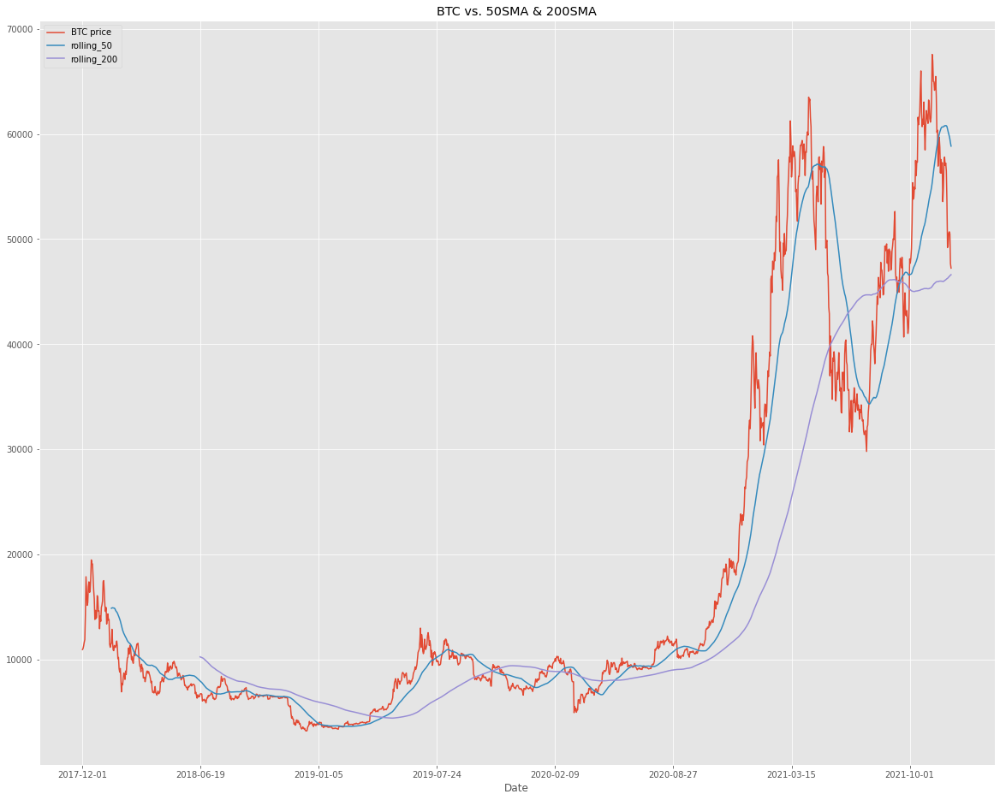

In [ ]:
#INVESTIGATE OUR PREDICTED VARIABLE(BTC PRICE)

%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use("ggplot")
df['rolling_50'] = df.rolling(50).agg({'BTC price':'mean'})
df['rolling_200'] = df.rolling(200).agg({'BTC price':'mean'})
df_recent = df[-2000:]
df[['BTC price', 'rolling_50', 'rolling_200']].plot(title='BTC vs. 50SMA & 200SMA', figsize=(20,16), xlabel='Date')

We can easily see that the price of Bitcoin is not stationary. A clear trend exists between 2020 and 2021 with an increasing variance And high violatility in 2021.

In [ ]:
#Fill missing values for Google trends
df['Google trends']=df['Google trends'].fillna(method='ffill').fillna(method='bfill')

#fill missing value for rest columns
df[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC']]=\
df[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC']].\
interpolate(method='linear', axis=0,limit_direction='both')

In [ ]:
df=df.drop(columns=['rolling_50','rolling_200'])

#split data to predict the last 90 days
n_obs = 90
df_train, df_test = df[0:-n_obs], df[-n_obs:]

In [ ]:
#Augmented Dickey-Fuller Test (ADF Test) to check the stationary of each variable in the dataset. 

def Augmented_Dickey_Fuller_Test_func(series , column_name):
    print (f'Results of Dickey-Fuller Test for column: {column_name}')
    dftest = adfuller(series, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','No Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
       dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput)
    if dftest[1] <= 0.05:
        print("Conclusion:====>")
        print("Reject the null hypothesis")
        print("Data is stationary")
    else:
        print("Conclusion:====>")
        print("Fail to reject the null hypothesis")
        print("Data is non-stationary")

In [ ]:
for name, column in df_train.iteritems():
    Augmented_Dickey_Fuller_Test_func(df_train[name],name)
    print('\n')

Results of Dickey-Fuller Test for column: BTC price
Test Statistic                   -0.289835
p-value                           0.926932
No Lags Used                     24.000000
Number of Observations Used    1356.000000
Critical Value (1%)              -3.435182
Critical Value (5%)              -2.863674
Critical Value (10%)             -2.567906
dtype: float64
Conclusion:====>
Fail to reject the null hypothesis
Data is non-stationary


Results of Dickey-Fuller Test for column: DJI
Test Statistic                   -0.863531
p-value                           0.799745
No Lags Used                     20.000000
Number of Observations Used    1360.000000
Critical Value (1%)              -3.435167
Critical Value (5%)              -2.863668
Critical Value (10%)             -2.567903
dtype: float64
Conclusion:====>
Fail to reject the null hypothesis
Data is non-stationary


Results of Dickey-Fuller Test for column: Nasdaq composite index
Test Statistic                    0.629816
p-value 

The p-values are all well above the 0.05 alpha level, we cannot reject the null hypothesis. The time series are not stationary. Our dataset is not stationary First-Order Differencing will be applied to remove the price trend or seasonality from the data. A first-order difference is the first period minus the prior period -- it's the rate of change or returns when we're talking about stocks. y = y_t1 - y_t2

In [ ]:
#eliminating the trend and seasonality by differencing 
train_diff = df_train.diff()
train_diff.dropna(inplace = True)
for name, column in train_diff.iteritems():
    Augmented_Dickey_Fuller_Test_func(train_diff[name],name)
    print('\n')

Results of Dickey-Fuller Test for column: BTC price
Test Statistic                -7.365661e+00
p-value                        9.251150e-11
No Lags Used                   2.300000e+01
Number of Observations Used    1.356000e+03
Critical Value (1%)           -3.435182e+00
Critical Value (5%)           -2.863674e+00
Critical Value (10%)          -2.567906e+00
dtype: float64
Conclusion:====>
Reject the null hypothesis
Data is stationary


Results of Dickey-Fuller Test for column: DJI
Test Statistic                -8.062627e+00
p-value                        1.627562e-12
No Lags Used                   1.900000e+01
Number of Observations Used    1.360000e+03
Critical Value (1%)           -3.435167e+00
Critical Value (5%)           -2.863668e+00
Critical Value (10%)          -2.567903e+00
dtype: float64
Conclusion:====>
Reject the null hypothesis
Data is stationary


Results of Dickey-Fuller Test for column: Nasdaq composite index
Test Statistic                -8.296724e+00
p-value          

After transforming the data, the p-values are all well below the 0.05 alpha level, therefore, we reject the null hypothesis. So the current data is stationary.

### Causality TEST

In [ ]:
from statsmodels.tsa.stattools import grangercausalitytests

maxlag=15
test = 'ssr_chi2test'

def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
   
    train_diff = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in train_diff.columns:
        for r in train_diff.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            train_diff.loc[r, c] = min_p_value
    train_diff.columns = [var + '_x' for var in variables]
    train_diff.index = [var + '_y' for var in variables]
    return train_diff

grangers_causation_matrix(train_diff, variables = train_diff.columns)

,BTC price_x,DJI_x,Nasdaq composite index_x,Gold in USD_x,Ethereum Price_x,Litecoin Price_x,Bitcoin Cash Price_x,Cardano Price_x,BTC network hashrate_x,Average BTC block size_x,NUAU - BTC_x,Number TX - BTC_x,Difficulty - BTC_x,TX fees - BTC_x,Estimated TX Volume USD - BTC_x,Google trends_x
BTC price_y,1.0000,0.2014,0.2445,0.0658,0.8945,0.7939,0.5316,0.8190,0.0002,0.5249,0.0200,0.0512,0.0031,0.0815,0.0011,0.0000
DJI_y,0.4197,1.0000,0.0679,0.0100,0.0000,0.1173,0.1757,0.0000,0.0015,0.2474,0.2695,0.0021,0.1867,0.7119,0.2109,0.3236
Nasdaq composite index_y,0.0025,0.0001,1.0000,0.0173,0.0000,0.0104,0.0007,0.0000,0.0067,0.2788,0.2097,0.0826,0.2532,0.4601,0.1215,0.0900
Gold in USD_y,0.6517,0.0000,0.0012,1.0000,0.0000,0.0460,0.0032,0.2531,0.0088,0.0204,0.2884,0.1911,0.1549,0.2267,0.3644,0.1476
Ethereum Price_y,0.6592,0.1499,0.5412,0.0000,1.0000,0.0032,0.2726,0.0000,0.0096,0.7317,0.3547,0.1727,0.3913,0.4709,0.4195,0.6816
Litecoin Price_y,0.2625,0.3861,0.2543,0.1261,0.0000,1.0000,0.0000,0.0000,0.0125,0.6413,0.0256,0.3489,0.6576,0.1937,0.3717,0.4128
Bitcoin Cash Price_y,0.1002,0.6328,0.0481,0.0011,0.0021,0.0000,1.0000,0.0010,0.0002,0.8327,0.1487,0.8446,0.2766,0.6401,0.4062,0.8701
Cardano Price_y,0.6488,0.1626,0.0536,0.1283,0.0000,0.0000,0.0000,1.0000,0.6760,0.2048,0.2231,0.0010,0.5463,0.8444,0.1368,0.7701
BTC network hashrate_y,0.0272,0.0442,0.0637,0.0269,0.0004,0.1301,0.2238,0.0907,1.0000,0.0298,0.1437,0.1086,0.0163,0.1369,0.0003,0.0011
Average BTC block size_y,0.3696,0.0750,0.1693,0.4326,0.5582,0.1344,0.5321,0.0238,0.0173,1.0000,0.0000,0.0000,0.0000,0.1599,0.0080,0.6446


The row are the response (y) and the columns are the predictors (x). If a given p-value is < significance level (0.05), we can reject the null hypothesis. 'BTC price','BTC network hashrate','Difficulty - BTC','Estimated TX Volume USD - BTC','Google trends' have a fairly similar trend patterns over the years.

In [ ]:
df_mod= train_diff[['BTC price','BTC network hashrate','Difficulty - BTC','Estimated TX Volume USD - BTC','Google trends']]
#Check casuality text among the selected variables
grangers_causation_matrix(df_mod, variables = df_mod.columns)

,BTC price_x,BTC network hashrate_x,Difficulty - BTC_x,Estimated TX Volume USD - BTC_x,Google trends_x
BTC price_y,1.0000,0.0002,0.0031,0.0011,0.0000
BTC network hashrate_y,0.0272,1.0000,0.0163,0.0003,0.0011
Difficulty - BTC_y,0.0000,0.0000,1.0000,0.0000,0.0000
Estimated TX Volume USD - BTC_y,0.0000,0.0005,0.0003,1.0000,0.0000
Google trends_y,0.0000,0.0009,0.0016,0.0000,1.0000


All the time series in the above table are interchangeably Granger causing each other.

### Johansen's Cointegration test
Johansen's Cointegration  test is a way to determine if three or more time series are cointegrated.

In [ ]:
from statsmodels.tsa.vector_ar.vecm import coint_johansen

def cointegration_test(df=df_mod): 
    res = coint_johansen(df,-1,5)
    d = {'0.90':0, '0.95':1, '0.99':2}
    traces = res.lr1
    cvts = res.cvt[:, d[str(1-0.05)]]
    def adjust(val, length= 6): 
        return str(val).ljust(length)
    print('Column Name   >  Test Stat > C(95%)    =>   Signif  \n', '--'*20)
    for col, trace, cvt in zip(df.columns, traces, cvts):
        print(adjust(col), '> ', adjust(round(trace,2), 9), ">", adjust(cvt, 8), ' =>  ' , trace > cvt)
cointegration_test()

Column Name   >  Test Stat > C(95%)    =>   Signif  
 ----------------------------------------
BTC price >  2171.65   > 60.0627   =>   True
BTC network hashrate >  1052.12   > 40.1749   =>   True
Difficulty - BTC >  623.61    > 24.2761   =>   True
Estimated TX Volume USD - BTC >  355.78    > 12.3212   =>   True
Google trends >  170.94    > 4.1296    =>   True


In [ ]:
from statsmodels.tsa.api import VAR

#fit Var

model = VAR(df_mod)
for i in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

Lag Order = 1
AIC :  141.76402883694269
BIC :  141.87778765951978
FPE :  3.6926281447021503e+61
HQIC:  141.80658647871812 

Lag Order = 2
AIC :  141.5854592044989
BIC :  141.79413944022934
FPE :  3.088761580210588e+61
HQIC:  141.66353015698684 

Lag Order = 3
AIC :  141.50458180230123
BIC :  141.8082949467444
FPE :  2.848795744825119e+61
HQIC:  141.61821034877028 

Lag Order = 4
AIC :  141.40878864460208
BIC :  141.80764640764116
FPE :  2.588580931368684e+61
HQIC:  141.5580191558081 

Lag Order = 5
AIC :  141.28308720519126
BIC :  141.7772015116008
FPE :  2.2828372428832545e+61
HQIC:  141.4679641396129 

Lag Order = 6
AIC :  141.03378262860033
BIC :  141.6232656186158
FPE :  1.7791402650394065e+61
HQIC:  141.2543505326753 

Lag Order = 7
AIC :  140.9991870699832
BIC :  141.68415109987268
FPE :  1.7186799209385422e+61
HQIC:  141.25549057834556 

Lag Order = 8
AIC :  140.98464833702718
BIC :  141.76520597966464
FPE :  1.6939221969861038e+61
HQIC:  141.27673217274534 

Lag Order = 9
AIC :

There is no hard-and-fast-rule on the choice of lag order. It is basically an empirical issue. However, it is often advised to use the AIC in selecting the lag order with the smallest value. Therefore, we will select lag order = 15.

In [ ]:
results = model.fit(maxlags=15, ic='aic')
results.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Thu, 17, Mar, 2022
Time:                     23:38:37
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                    142.275
Nobs:                     1365.00    HQIC:                   141.366
Log likelihood:          -105415.    FPE:                1.44054e+61
AIC:                      140.822    Det(Omega_mle):     1.09868e+61
--------------------------------------------------------------------
Results for equation BTC price
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                    16.824330        24.163612            0.696           0.486
L1.BTC price                             -0.063354         0.027772          

### Durbin-Watson Statistic
The Durbin Watson Test is a measure of autocorrelation in residuals from regression analysis.

In [ ]:
from statsmodels.stats.stattools import durbin_watson
out = durbin_watson(results.resid)

for col, val in zip(df_mod.columns, out):
    print(col, ':', round(val, 2))

BTC price : 1.99
BTC network hashrate : 2.0
Difficulty - BTC : 2.02
Estimated TX Volume USD - BTC : 2.0
Google trends : 1.97


2 is no autocorrelation

0 to <2 is positive autocorrelation (common in time series data).

2 to 4 is negative autocorrelation (less common in time series data). A rule of thumb is that test statistic values in the range of 1.5 to 2.5 are relatively normal. Values outside of this range could be cause for concern.

In [ ]:
#put selected variables into a data frame
df_test=df_test[['BTC price', 'BTC network hashrate', 'Difficulty - BTC','Estimated TX Volume USD - BTC', 'Google trends']]
lag_order = results.k_ar

df_input = df_mod.values[-lag_order:]
df_forecast = results.forecast(y=df_input, steps=n_obs)
df_forecast = (pd.DataFrame(df_forecast, index=df_test.index, columns=df_test.columns + '_pred'))

#revert the difference transformation for prediction
def invert_transformation(dat, pred):
    forecast = df_forecast.copy()
    columns = dat.columns
    for col in columns:
        forecast[str(col)+'_pred'] = dat[col].iloc[-1] + forecast[str(col)+'_pred'].cumsum()
    return forecast
output = invert_transformation(df_train[['BTC price','BTC network hashrate','Difficulty - BTC','Estimated TX Volume USD - BTC','Google trends']], df_forecast)

combined = pd.concat([output['BTC price_pred'], df_test['BTC price'], output['BTC network hashrate_pred'], df_test['BTC network hashrate'], output['Difficulty - BTC_pred'],df_test['Difficulty - BTC'],output['Estimated TX Volume USD - BTC_pred'], df_test['Estimated TX Volume USD - BTC'], output['Google trends_pred'], df_test['Google trends']], axis=1)

In [ ]:
#IMPORT EVALUATION METRICS

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error


rmse = mean_squared_error(combined['BTC price_pred'], combined['BTC price'], squared=False)
mae = mean_absolute_error(combined['BTC price_pred'], combined['BTC price'])
mse = mean_squared_error(combined['BTC price_pred'], combined['BTC price'])

print('Forecast accuracy of BTC')
print('RMSE: ', round(rmse,2))
print('MAE: ', round(mae,2))
print('MSE: ', round(mse,2))

Forecast accuracy of BTC
RMSE:  12073.01
MAE:  10342.71
MSE:  145757486.77


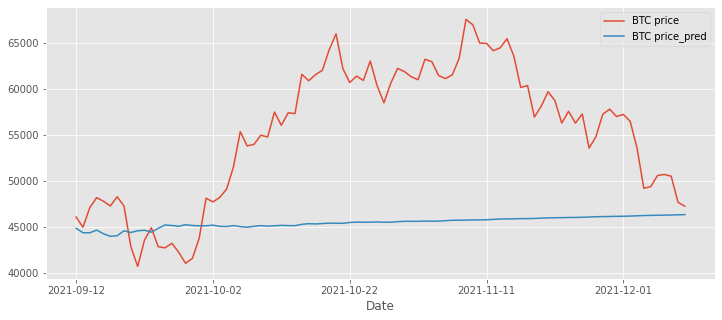

In [ ]:
df_fin=df[['BTC price']]
#plot prediction from 04/12/21 to 10/12/21 
test_original = df[-n_obs:]
test_original['BTC price'].plot(figsize=(12,5),legend=True)
combined['BTC price_pred'].plot(legend=True)

# Prediction  

Models Validation check by feeding new data

In [ ]:
valid = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bitcoin_test.csv')
valid.set_index('Date',inplace=True)
valid.info()

<class 'pandas.core.frame.DataFrame'>
Index: 90 entries, 2021-12-11 to 2022-03-10
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   BTC price                      90 non-null     float64
 1   DJI                            60 non-null     float64
 2   Nasdaq composite index         60 non-null     float64
 3   Gold in USD                    60 non-null     float64
 4   Ethereum Price                 90 non-null     float64
 5   Litecoin Price                 90 non-null     float64
 6   Bitcoin Cash Price             90 non-null     float64
 7   Cardano Price                  90 non-null     float64
 8   BTC network hashrate           90 non-null     float64
 9   Average BTC block size         90 non-null     float64
 10  NUAU - BTC                     90 non-null     float64
 11  Number TX - BTC                90 non-null     float64
 12  Difficulty - BTC               90 non-nu

Fill null value for validation data

In [ ]:
#Fill missing values for Google trends
valid['Google trends']=valid['Google trends'].fillna(method='ffill').fillna(method='bfill')

#fill missing value for rest columns
valid[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC','Estimated TX Volume USD - BTC']]=\
valid[['DJI', 'Nasdaq composite index', 'Gold in USD', 'NUAU - BTC','Estimated TX Volume USD - BTC']].\
interpolate(method='linear', axis=0,limit_direction='both')

In [ ]:
y_valid = valid["BTC price"]
x_valid = valid.iloc[:,1:]

date_valid=x_valid.index.values
x_valid

,DJI,Nasdaq composite index,Gold in USD,Ethereum Price,Litecoin Price,Bitcoin Cash Price,Cardano Price,BTC network hashrate,Average BTC block size,NUAU - BTC,Number TX - BTC,Difficulty - BTC,TX fees - BTC,Estimated TX Volume USD - BTC,Google trends
Date,,,,,,,,,,,,,,,
2021-12-11,35650.949219,15413.280273,167.000000,138.143052,60.264057,153.409524,0.049591,1.761618e+08,0.886238,599422.0,694005972.0,2.346868e+13,7.930528,1.275484e+09,26.0
2021-12-12,35650.949219,15413.280273,167.000000,137.063216,59.014809,159.845582,0.049769,1.683856e+08,0.863115,567489.0,694231777.0,2.419529e+13,6.540188,1.275484e+09,26.0
2021-12-13,35650.949219,15413.280273,167.000000,137.928077,59.178289,159.334902,0.051764,1.695883e+08,1.197347,690479.0,694448559.0,2.419529e+13,12.937332,4.853088e+09,26.0
2021-12-14,35544.179688,15237.639648,165.440002,138.685892,60.116424,157.904888,0.053275,1.780076e+08,1.149543,684529.0,694725859.0,2.419529e+13,11.712148,4.698418e+09,26.0
2021-12-15,35927.429688,15565.580078,166.149994,134.586574,58.520244,152.356541,0.052608,1.695883e+08,1.396580,707659.0,695004157.0,2.419529e+13,11.622152,3.686558e+09,26.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-06,33083.186198,12991.786784,185.500000,246.746325,129.122536,393.562927,0.085202,1.794090e+08,1.067880,555454.0,715437707.0,2.755033e+13,9.457118,1.221416e+09,24.0
2022-03-07,32817.378906,12830.959961,186.410004,245.800911,136.360991,389.058791,0.087948,2.026911e+08,1.180209,648259.0,715644535.0,2.755033e+13,11.280762,4.567258e+09,24.0
2022-03-08,32632.640625,12795.549805,191.509995,259.656640,134.805536,394.695511,0.095977,2.026911e+08,1.243528,659214.0,715900824.0,2.755033e+13,10.584157,3.918673e+09,24.0


Standardisation for validation data

In [ ]:
y_valid=y_valid.values.reshape(-1,1)

x_valid=std_scale.fit_transform(x_valid)
y_valid=std_scale.fit_transform(y_valid)

#transforming data from array to data frame
x_valid=pd.DataFrame(x_valid,columns=features)
x_valid

,DJI,Nasdaq composite index,Gold in USD,Ethereum Price,Litecoin Price,Bitcoin Cash Price,Cardano Price,BTC network hashrate,Average BTC block size,NUAU - BTC,Number TX - BTC,Difficulty - BTC,TX fees - BTC,Estimated TX Volume USD - BTC,Google trends
0,0.596106,1.152261,-0.944330,-1.158325,-1.265288,-1.744829,-2.356148,-0.623911,-1.653011,-0.971957,-1.715818,-1.565637,-1.030510,-1.667141,-0.335726
1,0.596106,1.152261,-0.944330,-1.181262,-1.326341,-1.673020,-2.340812,-1.041516,-1.786388,-1.571343,-1.681328,-1.086500,-1.416504,-1.667141,-0.335726
2,0.596106,1.152261,-0.944330,-1.162892,-1.318352,-1.678717,-2.169058,-0.976925,0.141587,0.737194,-1.648217,-1.086500,0.359507,0.354098,-0.335726
3,0.493981,0.950577,-1.226426,-1.146795,-1.272503,-1.694673,-2.038931,-0.524784,-0.134167,0.625512,-1.605861,-1.086500,0.019364,0.266714,-0.335726
4,0.860557,1.327144,-1.098038,-1.233869,-1.350512,-1.756578,-2.096331,-0.976925,1.290840,1.059665,-1.563354,-1.086500,-0.005621,-0.304956,-0.335726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,-1.859939,-1.628290,2.401045,1.148540,2.099958,0.934660,0.710357,-0.449525,-0.605226,-1.797241,1.557702,1.125867,-0.606690,-1.697688,-0.856680
86,-2.114182,-1.812964,2.565602,1.128458,2.453715,0.884406,0.946816,0.800794,0.042728,-0.055280,1.589294,1.125867,-0.100399,0.192612,-0.856680
87,-2.290882,-1.853625,3.487839,1.422771,2.377697,0.947297,1.638124,0.800794,0.407976,0.150346,1.628440,1.125867,-0.293795,-0.173818,-0.856680
88,-1.665710,-1.325416,2.458913,1.331001,2.204386,1.148741,1.107339,0.065312,0.442902,0.960202,1.667483,1.125867,-0.105803,1.114598,-0.856680


### KNN Prediction

In [ ]:
ypred_knn = knn.predict(x_valid)
#MSE for validation set
print ("Validation Mean Square error (knn):", mean_squared_error(y_valid, ypred_knn))

Validation Mean Square error (knn): 1.4487073604946457


### Random forest

In [ ]:
ypred_rfr = rfr.predict(x_valid)
#MSE for validation set
print ("Validation Mean Square error (random forest):", mean_squared_error(y_valid, ypred_rfr))

Validation Mean Square error (random forest): 0.9173154083538169


### SVM

In [ ]:
ypred_svm= svm.predict(x_valid)
#MSE for validation set
print ("Validation Mean Square error (SVM):", mean_squared_error(y_valid, ypred_svm))

Validation Mean Square error (SVM): 0.800687684080526


### Voting

In [ ]:
ypred_voting_reg = voting_reg.predict(x_valid)
#MSE for validation set
print ("Validation Mean Square error (voting):", mean_squared_error(y_valid, ypred_voting_reg))

Validation Mean Square error (voting): 0.8331570675461304


### Prediction plot (Comparison of machine learning)

Scatter plot for prediction values of different model and comparing them with validation data

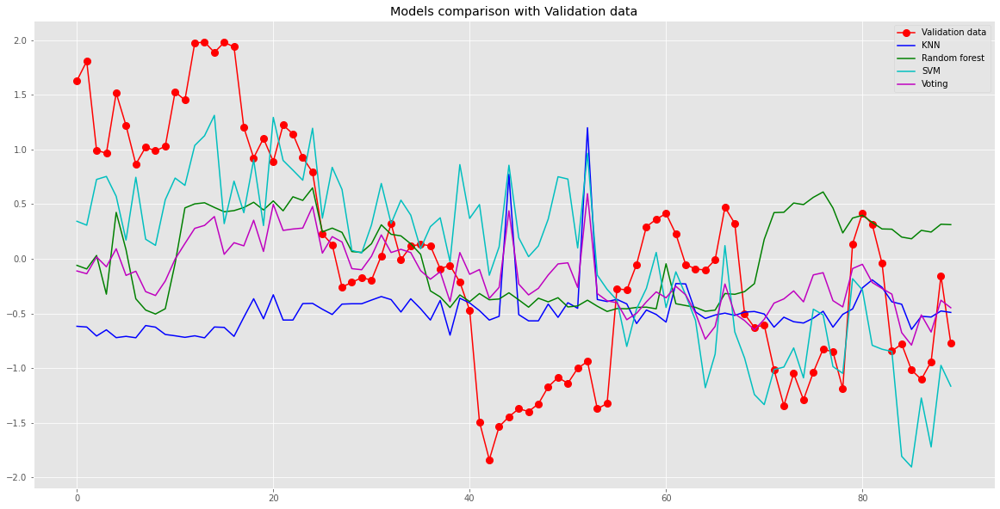

In [ ]:
plt.figure(figsize=(20,10))
plt.plot(date_valid,y_valid,'o-',markersize=8, color='r',label='Validation data')
plt.plot(date_valid,ypred_knn, color='b', label='KNN')
plt.plot(date_valid,ypred_rfr, color='g', label='Random forest')
plt.plot(date_valid,ypred_svm , color='c', label='SVM')
plt.plot(date_valid,ypred_voting_reg , color='m', label='Voting')
plt.legend()
plt.title("Models comparison with Validation data")
plt.show()

### Multiple linear Regression

In [ ]:
ypred_mlnr = myvalues.predict(x_valid)
#MSE for validation set
print ("Validation Mean Square error (Multiple linear):", mean_squared_error(y_valid, ypred_mlnr))

Validation Mean Square error (Multiple linear): 0.9476746720126962


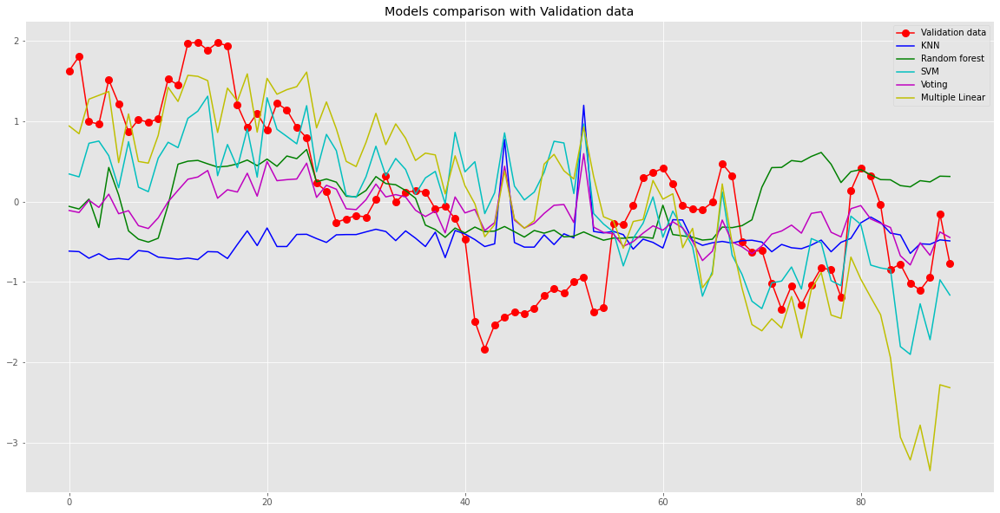

In [ ]:
plt.figure(figsize=(20,10))
plt.plot(date_valid,y_valid,'o-',markersize=8, color='r',label='Validation data')
plt.plot(date_valid,ypred_knn, color='b', label='KNN')
plt.plot(date_valid,ypred_rfr, color='g', label='Random forest')
plt.plot(date_valid,ypred_svm , color='c', label='SVM')
plt.plot(date_valid,ypred_voting_reg , color='m', label='Voting')
plt.plot(date_valid,ypred_mlnr , color='y', label='Multiple Linear')
plt.legend()
plt.title("Models comparison with Validation data")
plt.show()